In [1]:
# Para visuzalización en notebook
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (8,6)
mpl.rcParams['font.size'] = 22
from IPython.display import Audio, Markdown, Image
import seaborn as sns

# Números y Datos
import numpy as np
import pandas as pd

# Archivos
import urllib.request
import glob

# Machine learning
# importar los paquetes para clustering
from sklearn.preprocessing import StandardScaler

# Trabajo Práctico 1



In [3]:
# Bajar zip con los datos de audio_analysis
# urllib.request.urlretrieve('https://www.dropbox.com/s/gldffl4k2fmgo70/audio_analysis.zip?dl=1','data/audio_analysis.zip')
#!unzip -qq -o -d data  data/audio_analysis.zip 

## Carga archivos audio_analysis 

In [2]:
audio_analysis_files = glob.glob('data/audio_analysis/timbre/*')
audio_analysis = []
for filename in audio_analysis_files:
    audio_analysis.append( pd.read_csv(filename, index_col='start') )

In [4]:
# Cada elemento del array son todos los muestreos de timbres para cada canción
len(audio_analysis)

2205

In [49]:
audio_analysis[0].head()

,0,1,2,3,4,5,6,7,8,9,10,11
start,,,,,,,,,,,,
0.00000,10.050,4.733,-0.081,-37.335,72.253,-47.053,25.460,6.528,-32.078,2.168,0.273,-7.991
0.33488,12.048,-12.944,-6.034,-39.826,47.432,-45.425,12.213,4.486,-34.127,-4.248,-9.499,-23.253
0.58481,12.978,-20.658,6.997,-22.122,56.973,-48.559,11.791,-2.068,-27.104,2.394,-9.744,-27.107
1.17778,13.316,-29.519,13.462,-36.836,59.545,-37.876,19.442,7.070,-39.110,-3.678,4.177,-13.145
2.07882,14.470,-29.095,22.362,-25.384,48.683,-44.461,10.759,6.195,-31.741,-0.398,1.808,-9.778


In [7]:
audio_analysis[1].head()

,0,1,2,3,4,5,6,7,8,9,10,11
start,,,,,,,,,,,,
0.00000,0.000,171.130,9.469,-28.480,57.491,-50.067,14.833,5.359,-27.228,0.973,-10.640,-7.228
0.57429,9.181,77.120,48.668,-159.238,28.341,10.338,-29.955,-71.441,-56.137,27.831,17.880,-11.169
0.84268,20.253,-39.528,17.862,-43.676,9.463,-16.022,-75.945,-22.006,-18.853,-8.124,0.075,-12.106
1.03905,24.592,-35.764,40.329,-6.925,13.101,-8.038,-54.644,-16.683,-15.106,-17.647,11.714,-11.474
1.20875,24.552,-42.061,34.849,16.672,12.095,-22.920,-52.631,-21.466,-27.570,-9.140,13.283,-3.308


In [13]:
audio_analysis[0].shape

(915, 12)

In [14]:
audio_analysis[0].describe

<bound method NDFrame.describe of                 0        1        2       3       4       5       6       7  \
start                                                                         
0.00000    10.050    4.733   -0.081 -37.335  72.253 -47.053  25.460   6.528   
0.33488    12.048  -12.944   -6.034 -39.826  47.432 -45.425  12.213   4.486   
0.58481    12.978  -20.658    6.997 -22.122  56.973 -48.559  11.791  -2.068   
1.17778    13.316  -29.519   13.462 -36.836  59.545 -37.876  19.442   7.070   
2.07882    14.470  -29.095   22.362 -25.384  48.683 -44.461  10.759   6.195   
2.25841    15.259  -29.029   29.953 -15.575  40.535 -48.973  11.021  -2.233   
2.76794    15.947  -39.005   41.663 -11.354  50.456 -34.102   2.288   2.677   
3.15796    16.106  -48.101   44.824  -9.528  64.953 -49.695   8.195  14.255   
3.41796    16.529  -45.387   31.509 -22.022  38.794 -39.848   5.474   6.817   
4.22540    17.654  -45.939   45.106  -3.087  47.174 -32.896  -2.264   5.156   
4.45243    17.890 

In [76]:
audio_analysis[0].mean()

0     39.573680
1    -53.160322
2     33.955933
3    -13.458602
4     10.908333
5    -34.851049
6      1.713744
7      0.357444
8     -9.248460
9     -3.464805
10    -1.074585
11    -0.824331
dtype: float64

In [77]:
audio_analysis[0].std()

0      7.664607
1     46.780848
2     24.761365
3     14.200565
4     17.446560
5      9.698054
6     14.747012
7     10.249290
8     10.888898
9      7.967957
10     6.617408
11    11.606093
dtype: float64

In [23]:
audio_analysis[0].columns

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11'], dtype='object')

In [56]:
col_mean_renames = {}
for i in range(12):
    col_mean_renames.update({str(i): 'timbre_mean_' + str(i)})
col_mean_renames

{'0': 'timbre_mean_0',
 '1': 'timbre_mean_1',
 '2': 'timbre_mean_2',
 '3': 'timbre_mean_3',
 '4': 'timbre_mean_4',
 '5': 'timbre_mean_5',
 '6': 'timbre_mean_6',
 '7': 'timbre_mean_7',
 '8': 'timbre_mean_8',
 '9': 'timbre_mean_9',
 '10': 'timbre_mean_10',
 '11': 'timbre_mean_11'}

In [57]:
col_std_renames = {}
for i in range(12):
    col_std_renames.update({str(i): 'timbre_std_' + str(i)})
col_std_renames

{'0': 'timbre_std_0',
 '1': 'timbre_std_1',
 '2': 'timbre_std_2',
 '3': 'timbre_std_3',
 '4': 'timbre_std_4',
 '5': 'timbre_std_5',
 '6': 'timbre_std_6',
 '7': 'timbre_std_7',
 '8': 'timbre_std_8',
 '9': 'timbre_std_9',
 '10': 'timbre_std_10',
 '11': 'timbre_std_11'}

In [58]:
timbres_means = []
for song in audio_analysis:
    timbres_means.append(song.mean())
df_timbres_means = pd.DataFrame(timbres_means)
df_timbres_means = df_timbres_means.rename(columns = col_mean_renames)
df_timbres_means.head()

,timbre_mean_0,timbre_mean_1,timbre_mean_2,timbre_mean_3,timbre_mean_4,timbre_mean_5,timbre_mean_6,timbre_mean_7,timbre_mean_8,timbre_mean_9,timbre_mean_10,timbre_mean_11
0,39.573680,-53.160322,33.955933,-13.458602,10.908333,-34.851049,1.713744,0.357444,-9.248460,-3.464805,-1.074585,-0.824331
1,37.806990,26.905931,45.066553,-1.566750,19.836837,-10.684136,-37.983923,-10.510028,-5.820575,-1.746866,-5.941400,-0.282435
2,50.307463,65.649677,-17.158870,-1.660690,30.536530,-47.617183,1.200309,1.357931,-2.241743,4.456728,-8.276168,-5.888623
3,38.453838,-46.715751,-16.638915,-3.838850,34.693517,-27.530044,5.632033,2.938340,7.223357,-0.045737,-11.028171,-1.748513
4,52.072411,98.597172,-16.693923,0.843767,42.616539,-42.602253,-3.609067,11.836476,2.011623,0.462091,-9.126143,-1.358982


In [59]:
timbres_stds = []
for song in audio_analysis:
    timbres_stds.append(song.std())
df_timbres_stds = pd.DataFrame(timbres_stds)
df_timbres_stds = df_timbres_stds.rename(columns = col_std_renames)
df_timbres_stds.head()

,timbre_std_0,timbre_std_1,timbre_std_2,timbre_std_3,timbre_std_4,timbre_std_5,timbre_std_6,timbre_std_7,timbre_std_8,timbre_std_9,timbre_std_10,timbre_std_11
0,7.664607,46.780848,24.761365,14.200565,17.446560,9.698054,14.747012,10.249290,10.888898,7.967957,6.617408,11.606093
1,6.555402,61.683571,34.467867,29.810459,22.479480,18.076098,20.686062,15.690804,13.412294,12.443158,12.783383,13.834938
2,6.399544,54.450290,41.862201,34.872806,27.417082,29.577501,22.205486,19.508612,15.199944,13.671585,15.853447,15.410730
3,8.501100,82.117230,42.559503,32.796889,34.355147,27.430667,21.202076,24.238903,19.215522,19.125128,14.369381,13.853736
4,4.995148,52.319897,42.764416,40.084949,21.971911,23.230058,28.308662,19.269549,11.970478,13.192957,12.879710,11.432639


In [60]:
df_timbres = pd.concat([df_timbres_means, df_timbres_stds], axis = 1)
df_timbres.shape

(2205, 24)

In [61]:
df_timbres.head()

,timbre_mean_0,timbre_mean_1,timbre_mean_2,timbre_mean_3,timbre_mean_4,timbre_mean_5,timbre_mean_6,timbre_mean_7,timbre_mean_8,timbre_mean_9,...,timbre_std_2,timbre_std_3,timbre_std_4,timbre_std_5,timbre_std_6,timbre_std_7,timbre_std_8,timbre_std_9,timbre_std_10,timbre_std_11
0,39.573680,-53.160322,33.955933,-13.458602,10.908333,-34.851049,1.713744,0.357444,-9.248460,-3.464805,...,24.761365,14.200565,17.446560,9.698054,14.747012,10.249290,10.888898,7.967957,6.617408,11.606093
1,37.806990,26.905931,45.066553,-1.566750,19.836837,-10.684136,-37.983923,-10.510028,-5.820575,-1.746866,...,34.467867,29.810459,22.479480,18.076098,20.686062,15.690804,13.412294,12.443158,12.783383,13.834938
2,50.307463,65.649677,-17.158870,-1.660690,30.536530,-47.617183,1.200309,1.357931,-2.241743,4.456728,...,41.862201,34.872806,27.417082,29.577501,22.205486,19.508612,15.199944,13.671585,15.853447,15.410730
3,38.453838,-46.715751,-16.638915,-3.838850,34.693517,-27.530044,5.632033,2.938340,7.223357,-0.045737,...,42.559503,32.796889,34.355147,27.430667,21.202076,24.238903,19.215522,19.125128,14.369381,13.853736
4,52.072411,98.597172,-16.693923,0.843767,42.616539,-42.602253,-3.609067,11.836476,2.011623,0.462091,...,42.764416,40.084949,21.971911,23.230058,28.308662,19.269549,11.970478,13.192957,12.879710,11.432639


Repetimos el mismo procedimiento con los pitches

In [62]:
pitches_files = glob.glob('data/audio_analysis/pitches/*')
pitches = []
for filename in pitches_files:
    pitches.append(pd.read_csv(filename, index_col='start'))

In [63]:
# Cada elemento del array son todos los muestreos de pitches para cada canción
len(pitches)

2205

In [64]:
pitches[0].head()

,0,1,2,3,4,5,6,7,8,9,10,11
start,,,,,,,,,,,,
0.00000,0.239,1.000,0.891,0.099,0.083,0.215,0.322,0.172,0.108,0.415,0.200,0.124
0.33488,0.334,1.000,0.957,0.152,0.060,0.257,0.288,0.136,0.070,0.203,0.104,0.091
0.58481,0.042,0.302,1.000,0.104,0.060,0.137,0.137,0.082,0.129,0.341,0.115,0.052
1.17778,0.034,0.277,1.000,0.091,0.045,0.093,0.079,0.087,0.068,0.294,0.122,0.057
2.07882,0.330,1.000,0.688,0.379,0.162,0.354,0.352,0.413,0.515,0.646,0.494,0.198


In [65]:
col_mean_renames = {}
for i in range(12):
    col_mean_renames.update({str(i): 'pitch_mean_' + str(i)})
col_mean_renames

{'0': 'pitch_mean_0',
 '1': 'pitch_mean_1',
 '2': 'pitch_mean_2',
 '3': 'pitch_mean_3',
 '4': 'pitch_mean_4',
 '5': 'pitch_mean_5',
 '6': 'pitch_mean_6',
 '7': 'pitch_mean_7',
 '8': 'pitch_mean_8',
 '9': 'pitch_mean_9',
 '10': 'pitch_mean_10',
 '11': 'pitch_mean_11'}

In [66]:
col_std_renames = {}
for i in range(12):
    col_std_renames.update({str(i): 'pitch_std_' + str(i)})
col_std_renames

{'0': 'pitch_std_0',
 '1': 'pitch_std_1',
 '2': 'pitch_std_2',
 '3': 'pitch_std_3',
 '4': 'pitch_std_4',
 '5': 'pitch_std_5',
 '6': 'pitch_std_6',
 '7': 'pitch_std_7',
 '8': 'pitch_std_8',
 '9': 'pitch_std_9',
 '10': 'pitch_std_10',
 '11': 'pitch_std_11'}

In [67]:
pitches_means = []
for song in pitches:
    pitches_means.append(song.mean())
df_pitches_means = pd.DataFrame(pitches_means)
df_pitches_means = df_pitches_means.rename(columns = col_mean_renames)
df_pitches_means.head()

,pitch_mean_0,pitch_mean_1,pitch_mean_2,pitch_mean_3,pitch_mean_4,pitch_mean_5,pitch_mean_6,pitch_mean_7,pitch_mean_8,pitch_mean_9,pitch_mean_10,pitch_mean_11
0,0.375884,0.542515,0.693280,0.297933,0.253832,0.511824,0.284066,0.179025,0.165990,0.571667,0.170922,0.124420
1,0.345639,0.271609,0.292444,0.230944,0.386810,0.314941,0.256701,0.387723,0.156433,0.236743,0.267108,0.233731
2,0.457729,0.517120,0.492810,0.367588,0.364575,0.376027,0.325243,0.395297,0.321865,0.378783,0.317345,0.253317
3,0.383214,0.351185,0.198129,0.195749,0.539399,0.283789,0.210853,0.294865,0.301922,0.763953,0.338184,0.217922
4,0.526263,0.743888,0.385282,0.383604,0.451625,0.371914,0.359564,0.285318,0.386283,0.274957,0.318695,0.334018


In [68]:
pitches_stds = []
for song in audio_analysis:
    pitches_stds.append(song.std())
df_pitches_stds = pd.DataFrame(pitches_stds)
df_pitches_stds = df_pitches_stds.rename(columns = col_std_renames)
df_pitches_stds.head()

,pitch_std_0,pitch_std_1,pitch_std_2,pitch_std_3,pitch_std_4,pitch_std_5,pitch_std_6,pitch_std_7,pitch_std_8,pitch_std_9,pitch_std_10,pitch_std_11
0,7.664607,46.780848,24.761365,14.200565,17.446560,9.698054,14.747012,10.249290,10.888898,7.967957,6.617408,11.606093
1,6.555402,61.683571,34.467867,29.810459,22.479480,18.076098,20.686062,15.690804,13.412294,12.443158,12.783383,13.834938
2,6.399544,54.450290,41.862201,34.872806,27.417082,29.577501,22.205486,19.508612,15.199944,13.671585,15.853447,15.410730
3,8.501100,82.117230,42.559503,32.796889,34.355147,27.430667,21.202076,24.238903,19.215522,19.125128,14.369381,13.853736
4,4.995148,52.319897,42.764416,40.084949,21.971911,23.230058,28.308662,19.269549,11.970478,13.192957,12.879710,11.432639


In [69]:
df_pitches = pd.concat([df_pitches_means, df_pitches_stds], axis = 1)
df_pitches.shape

(2205, 24)

In [70]:
df_pitches.head()

,pitch_mean_0,pitch_mean_1,pitch_mean_2,pitch_mean_3,pitch_mean_4,pitch_mean_5,pitch_mean_6,pitch_mean_7,pitch_mean_8,pitch_mean_9,...,pitch_std_2,pitch_std_3,pitch_std_4,pitch_std_5,pitch_std_6,pitch_std_7,pitch_std_8,pitch_std_9,pitch_std_10,pitch_std_11
0,0.375884,0.542515,0.693280,0.297933,0.253832,0.511824,0.284066,0.179025,0.165990,0.571667,...,24.761365,14.200565,17.446560,9.698054,14.747012,10.249290,10.888898,7.967957,6.617408,11.606093
1,0.345639,0.271609,0.292444,0.230944,0.386810,0.314941,0.256701,0.387723,0.156433,0.236743,...,34.467867,29.810459,22.479480,18.076098,20.686062,15.690804,13.412294,12.443158,12.783383,13.834938
2,0.457729,0.517120,0.492810,0.367588,0.364575,0.376027,0.325243,0.395297,0.321865,0.378783,...,41.862201,34.872806,27.417082,29.577501,22.205486,19.508612,15.199944,13.671585,15.853447,15.410730
3,0.383214,0.351185,0.198129,0.195749,0.539399,0.283789,0.210853,0.294865,0.301922,0.763953,...,42.559503,32.796889,34.355147,27.430667,21.202076,24.238903,19.215522,19.125128,14.369381,13.853736
4,0.526263,0.743888,0.385282,0.383604,0.451625,0.371914,0.359564,0.285318,0.386283,0.274957,...,42.764416,40.084949,21.971911,23.230058,28.308662,19.269549,11.970478,13.192957,12.879710,11.432639


In [72]:
df_audio_analysis_summaries = pd.concat([df_timbres, df_pitches], axis = 1)
df_audio_analysis_summaries.shape

(2205, 48)

In [74]:
df_audio_analysis_summaries.head()

,timbre_mean_0,timbre_mean_1,timbre_mean_2,timbre_mean_3,timbre_mean_4,timbre_mean_5,timbre_mean_6,timbre_mean_7,timbre_mean_8,timbre_mean_9,...,pitch_std_2,pitch_std_3,pitch_std_4,pitch_std_5,pitch_std_6,pitch_std_7,pitch_std_8,pitch_std_9,pitch_std_10,pitch_std_11
0,39.573680,-53.160322,33.955933,-13.458602,10.908333,-34.851049,1.713744,0.357444,-9.248460,-3.464805,...,24.761365,14.200565,17.446560,9.698054,14.747012,10.249290,10.888898,7.967957,6.617408,11.606093
1,37.806990,26.905931,45.066553,-1.566750,19.836837,-10.684136,-37.983923,-10.510028,-5.820575,-1.746866,...,34.467867,29.810459,22.479480,18.076098,20.686062,15.690804,13.412294,12.443158,12.783383,13.834938
2,50.307463,65.649677,-17.158870,-1.660690,30.536530,-47.617183,1.200309,1.357931,-2.241743,4.456728,...,41.862201,34.872806,27.417082,29.577501,22.205486,19.508612,15.199944,13.671585,15.853447,15.410730
3,38.453838,-46.715751,-16.638915,-3.838850,34.693517,-27.530044,5.632033,2.938340,7.223357,-0.045737,...,42.559503,32.796889,34.355147,27.430667,21.202076,24.238903,19.215522,19.125128,14.369381,13.853736
4,52.072411,98.597172,-16.693923,0.843767,42.616539,-42.602253,-3.609067,11.836476,2.011623,0.462091,...,42.764416,40.084949,21.971911,23.230058,28.308662,19.269549,11.970478,13.192957,12.879710,11.432639


In [75]:
df_audio_analysis_summaries.columns

Index(['timbre_mean_0', 'timbre_mean_1', 'timbre_mean_2', 'timbre_mean_3',
       'timbre_mean_4', 'timbre_mean_5', 'timbre_mean_6', 'timbre_mean_7',
       'timbre_mean_8', 'timbre_mean_9', 'timbre_mean_10', 'timbre_mean_11',
       'timbre_std_0', 'timbre_std_1', 'timbre_std_2', 'timbre_std_3',
       'timbre_std_4', 'timbre_std_5', 'timbre_std_6', 'timbre_std_7',
       'timbre_std_8', 'timbre_std_9', 'timbre_std_10', 'timbre_std_11',
       'pitch_mean_0', 'pitch_mean_1', 'pitch_mean_2', 'pitch_mean_3',
       'pitch_mean_4', 'pitch_mean_5', 'pitch_mean_6', 'pitch_mean_7',
       'pitch_mean_8', 'pitch_mean_9', 'pitch_mean_10', 'pitch_mean_11',
       'pitch_std_0', 'pitch_std_1', 'pitch_std_2', 'pitch_std_3',
       'pitch_std_4', 'pitch_std_5', 'pitch_std_6', 'pitch_std_7',
       'pitch_std_8', 'pitch_std_9', 'pitch_std_10', 'pitch_std_11'],
      dtype='object')

In [85]:
# Vamos a hacer la scatter matrix de los promedios
df_audio_analysis_summaries_means = pd.concat([df_audio_analysis_summaries.iloc[:,0:12], df_audio_analysis_summaries.iloc[:,24:36]], axis = 1)
df_audio_analysis_summaries_means.columns

Index(['timbre_mean_0', 'timbre_mean_1', 'timbre_mean_2', 'timbre_mean_3',
       'timbre_mean_4', 'timbre_mean_5', 'timbre_mean_6', 'timbre_mean_7',
       'timbre_mean_8', 'timbre_mean_9', 'timbre_mean_10', 'timbre_mean_11',
       'pitch_mean_0', 'pitch_mean_1', 'pitch_mean_2', 'pitch_mean_3',
       'pitch_mean_4', 'pitch_mean_5', 'pitch_mean_6', 'pitch_mean_7',
       'pitch_mean_8', 'pitch_mean_9', 'pitch_mean_10', 'pitch_mean_11'],
      dtype='object')

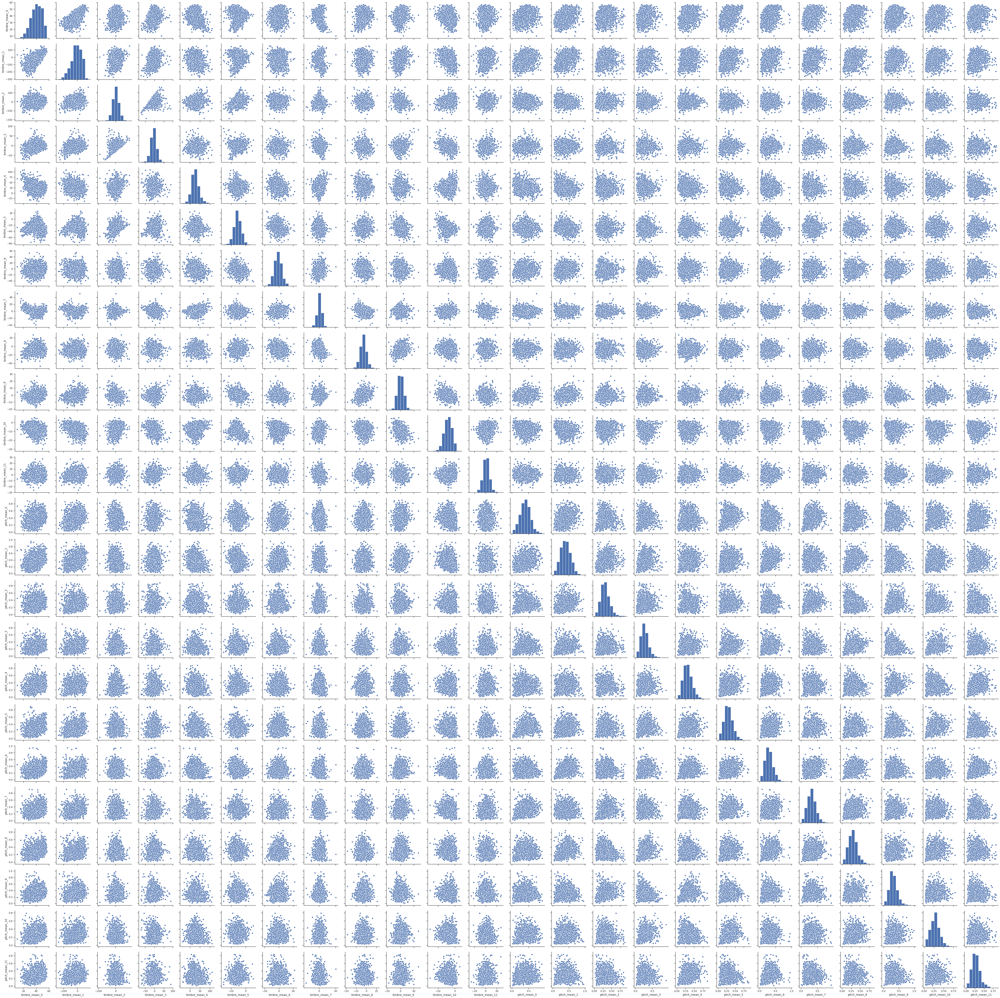

In [86]:
sns.set(style="ticks")
sns.pairplot(df_audio_analysis_summaries_means)

In [87]:
# Vamos a hacer la scatter matrix de las desviaciones
df_audio_analysis_summaries_std = pd.concat([df_audio_analysis_summaries.iloc[:,13:24], df_audio_analysis_summaries.iloc[:,37:48]], axis = 1)
df_audio_analysis_summaries_std.columns

Index(['timbre_std_1', 'timbre_std_2', 'timbre_std_3', 'timbre_std_4',
       'timbre_std_5', 'timbre_std_6', 'timbre_std_7', 'timbre_std_8',
       'timbre_std_9', 'timbre_std_10', 'timbre_std_11', 'pitch_std_1',
       'pitch_std_2', 'pitch_std_3', 'pitch_std_4', 'pitch_std_5',
       'pitch_std_6', 'pitch_std_7', 'pitch_std_8', 'pitch_std_9',
       'pitch_std_10', 'pitch_std_11'],
      dtype='object')

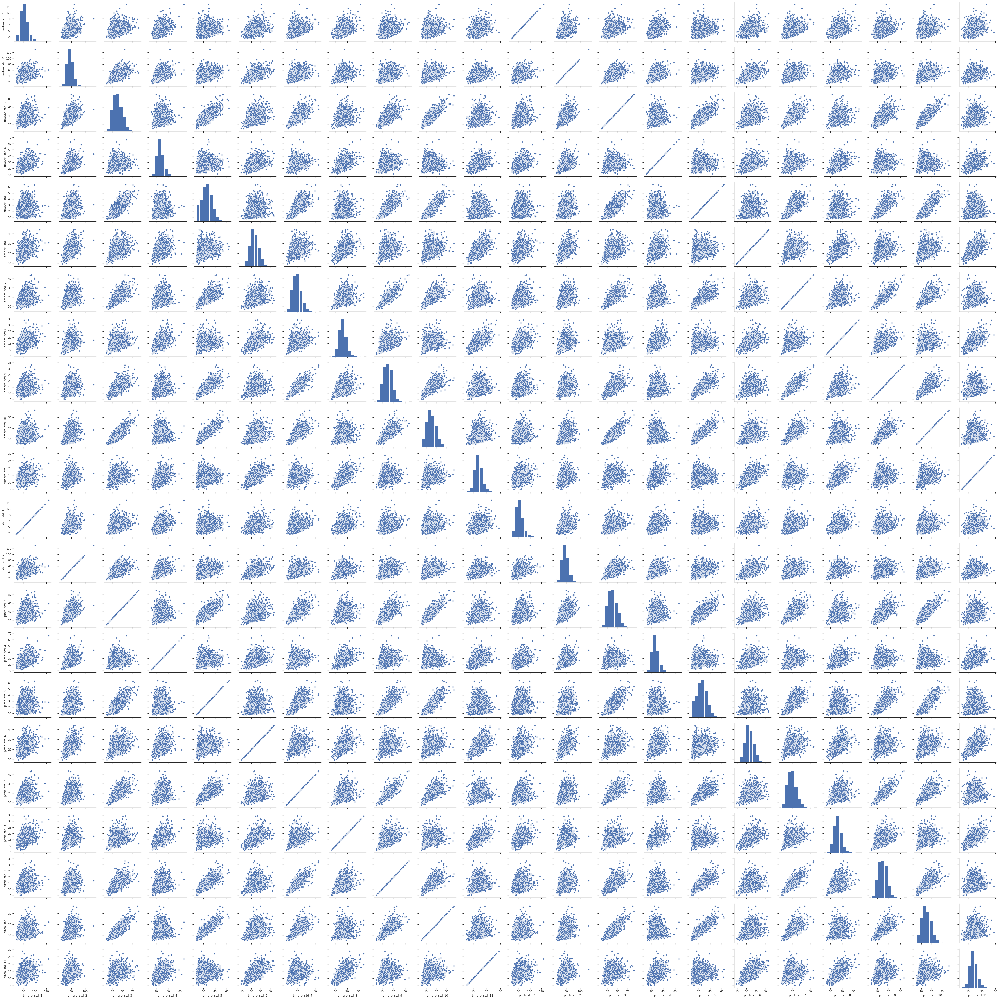

In [88]:
sns.set(style="ticks")
sns.pairplot(df_audio_analysis_summaries_std)

In [89]:
# Comparando solo 2 tonos y 2 timbres con todo (medias y std)
df_audio_analysis_summaries_only2 = pd.concat([df_audio_analysis_summaries.iloc[:,0:2], df_audio_analysis_summaries.iloc[:,12:14], df_audio_analysis_summaries.iloc[:,24:26], df_audio_analysis_summaries.iloc[:,36:38]], axis = 1)
df_audio_analysis_summaries_only2.columns

Index(['timbre_mean_0', 'timbre_mean_1', 'timbre_std_0', 'timbre_std_1',
       'pitch_mean_0', 'pitch_mean_1', 'pitch_std_0', 'pitch_std_1'],
      dtype='object')

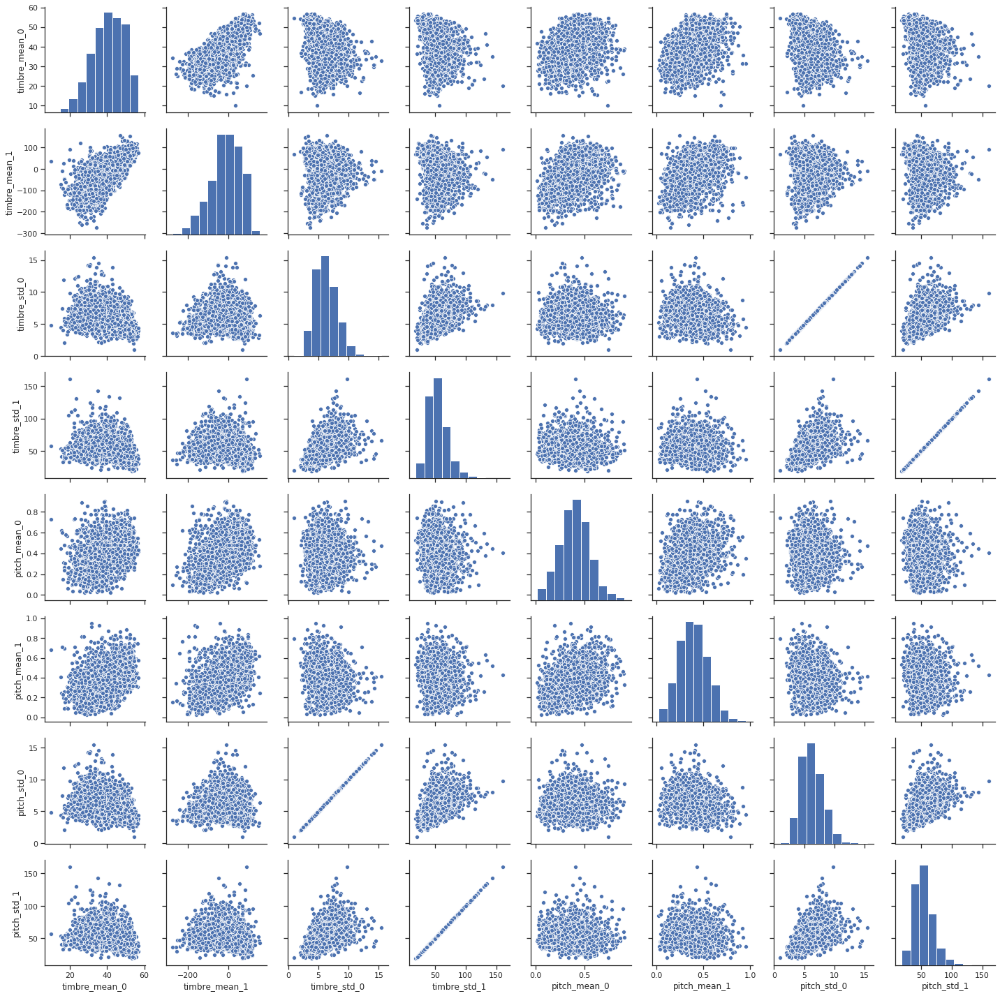

In [90]:
sns.set(style="ticks")
sns.pairplot(df_audio_analysis_summaries_only2)

In [91]:
ss = StandardScaler()

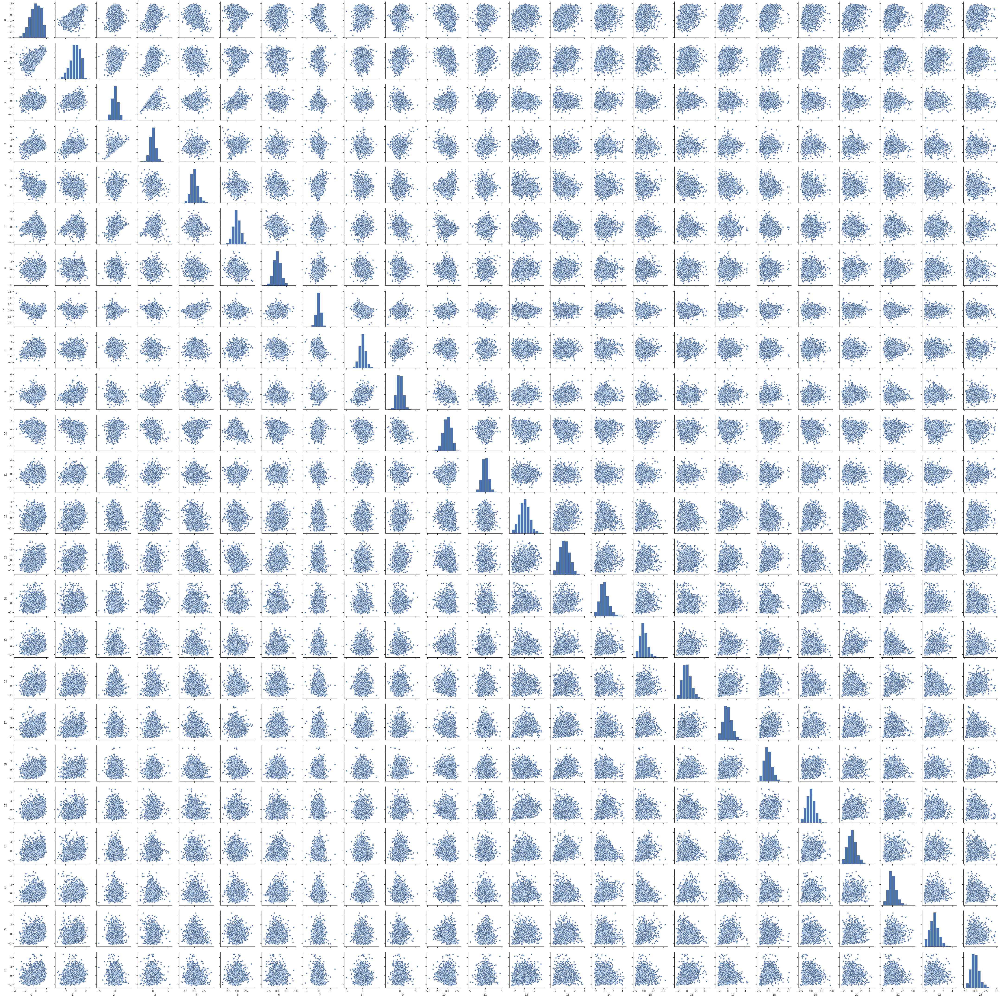

In [92]:
df_audio_analysis_summaries_means_norm = pd.DataFrame(ss.fit_transform(df_audio_analysis_summaries_means))
sns.set(style="ticks")
sns.pairplot(df_audio_analysis_summaries_means_norm)

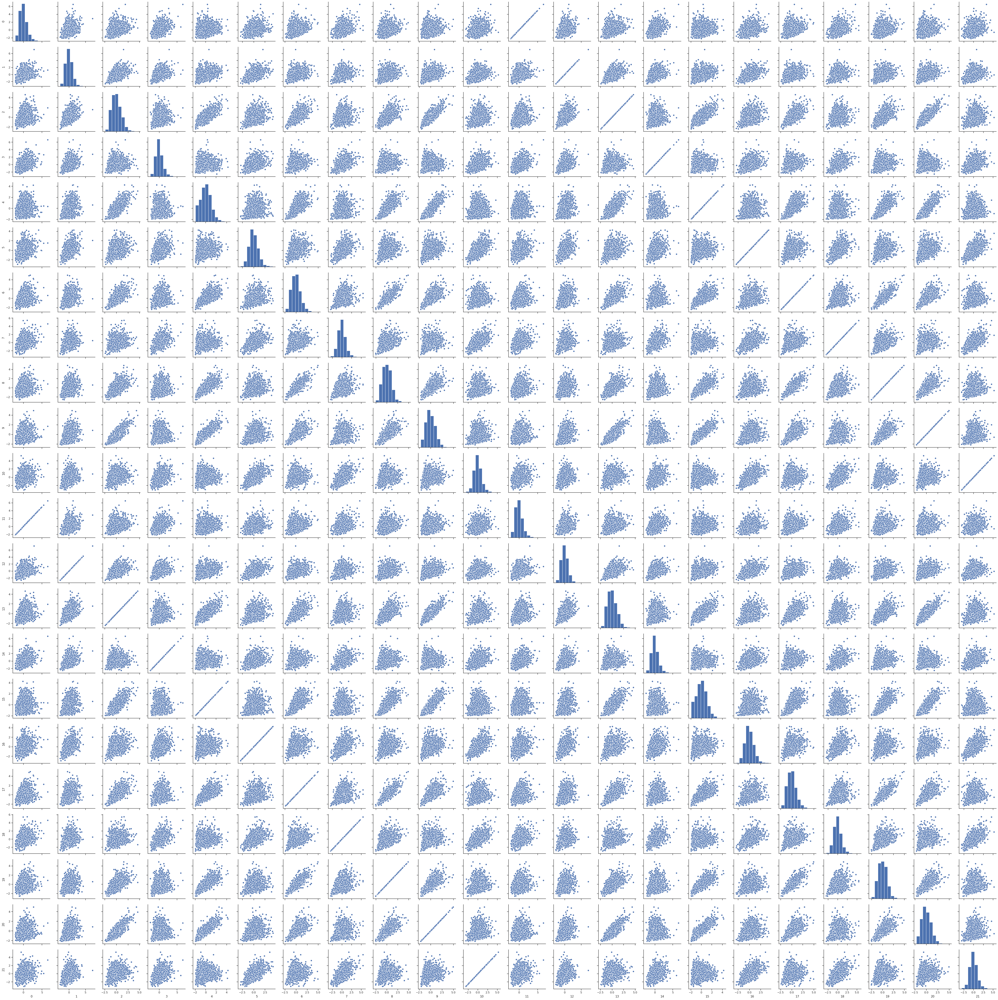

In [93]:
df_audio_analysis_summaries_std_norm = pd.DataFrame(ss.fit_transform(df_audio_analysis_summaries_std))
sns.set(style="ticks")
sns.pairplot(df_audio_analysis_summaries_std_norm)

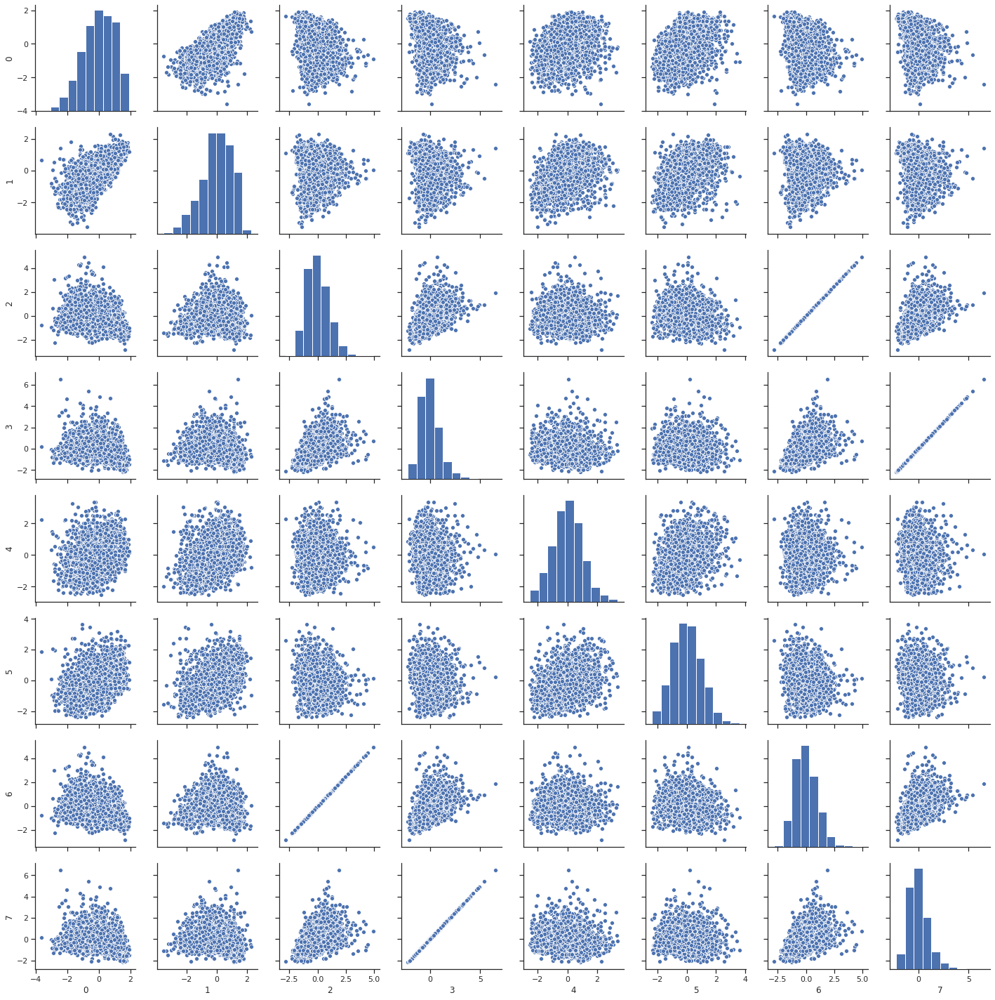

In [94]:
df_audio_analysis_summaries_only2_norm = pd.DataFrame(ss.fit_transform(df_audio_analysis_summaries_only2))
sns.set(style="ticks")
sns.pairplot(df_audio_analysis_summaries_only2_norm)